# Plot Based Clustering Using Convolutional Autoencoder Representations

All the project codes are given sequentially in this notebook. Please run the cells in the given order, because some variables must be defined to run another cell. The main sections are:

1. [Data Preparation and Visualization](#sectionb)

2. [Model Building and Training](#sectiona)

3. [Results](#sectionc)

<div style="text-align: right"> Ahmet Talha Yiğit / 507191101 </div>

<div style="text-align: right"> Barış Samak / 507201069 </div>

    

<a id='sectionb'></a>
## 1. Data Preparation and Visualization

The raw data is the synthetically created FMCG spendings grouped under 9 categories ,which are premium food, value-for-money food, economy food, premium cleaning, value-for-money cleaning, economy cleaning, premium personal care, value-for-money personal care and economy personal care of households in one year period. In the following cells, we have created an image dataset using the plots of each sample (rows in the raw data).

- Please do not use the cells under this section if you already have the image dataset, because it will recreate the plots. 

- We have provided small samples of each datasets to run the models in the next sections.  

- Full image datasets can be downloaded from the drive link below, you should just replace the folders to use them.  

- https://drive.google.com/drive/folders/1wiXDaD2CgTnH0HZ5dDFsts17kN3Ha61i?usp=sharing 



In [1]:
# Import needed packages for the data preparation stage
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from sklearn import preprocessing

In [3]:
csv = 'rawdata.csv' # Assign the name of the csv file.
all_data = pd.read_csv(csv, encoding = 'ISO-8859-1', index_col=0) # Read the csv file.
all_data.head() # Inspect the raw data.

,FOOD_PRE,FOOD_VFM,FOOD_ECO,CLEANO_PRE,CLEANO_VFM,CLEANO_ECO,PC_PRE,PC_VFM,PC_ECO,FOOD_TOT,CLEANO_TOT,PC_TOT,TOTAL
HH_ID,,,,,,,,,,,,,
1,1.441681e+06,1478077.698,5.058755e+05,0.00,61395.16,54419.75,49421.54,149790.85,57751.60,3.425634e+06,115814.91,256963.99,3.798413e+06
2,2.206887e+06,1273936.447,3.779446e+05,49145.11,72164.91,16382.00,149089.79,131144.35,11700.37,3.858768e+06,137692.02,291934.51,4.288394e+06
3,6.556622e+04,180024.000,1.092182e+05,2771.00,32766.75,24450.00,5040.00,29473.50,13406.75,3.548084e+05,59987.75,47920.25,4.627164e+05
4,2.031903e+06,3463044.034,9.880745e+05,11454.24,51583.47,5647.75,102780.48,95154.54,38787.21,6.483022e+06,68685.46,236722.23,6.788429e+06
5,3.803264e+06,3319775.853,1.060419e+06,0.00,97576.15,21531.57,57896.61,85542.36,96290.81,8.183459e+06,119107.72,239729.78,8.542296e+06


In [4]:
all_data.FOOD_TOT=all_data.FOOD_TOT+0.00001
all_data.CLEANO_TOT=all_data.CLEANO_TOT+0.00001
all_data.PC_TOT=all_data.PC_TOT+0.00001
all_data[['FOOD_PRE', 'FOOD_VFM', 'FOOD_ECO']]=all_data[['FOOD_PRE', 'FOOD_VFM', 'FOOD_ECO']].div(all_data.FOOD_TOT,axis=0) 
all_data[['CLEANO_PRE', 'CLEANO_VFM', 'CLEANO_ECO']]=all_data[['CLEANO_PRE', 'CLEANO_VFM', 'CLEANO_ECO']].div(all_data.CLEANO_TOT,axis=0) 
all_data[['PC_PRE', 'PC_VFM', 'PC_ECO']]=all_data[['PC_PRE', 'PC_VFM', 'PC_ECO']].div(all_data.PC_TOT,axis=0) 
print_data=all_data[['FOOD_PRE', 'FOOD_VFM', 'FOOD_ECO','CLEANO_PRE', 'CLEANO_VFM', 'CLEANO_ECO','PC_PRE', 'PC_VFM', 'PC_ECO']]

print_data.head() # Inspect the final data.

,FOOD_PRE,FOOD_VFM,FOOD_ECO,CLEANO_PRE,CLEANO_VFM,CLEANO_ECO,PC_PRE,PC_VFM,PC_ECO
HH_ID,,,,,,,,,
1,0.420851,0.431476,0.147674,0.000000,0.530114,0.469886,0.192329,0.582925,0.224746
2,0.571915,0.330141,0.097944,0.356921,0.524104,0.118976,0.510696,0.449225,0.040079
3,0.184793,0.507384,0.307823,0.046193,0.546224,0.407583,0.105175,0.615053,0.279772
4,0.313419,0.534171,0.152410,0.166764,0.751010,0.082226,0.434182,0.401967,0.163851
5,0.464750,0.405669,0.129581,0.000000,0.819226,0.180774,0.241508,0.356828,0.401664


In [5]:
indices=np.array(['FOOD_PRE', 'FOOD_VFM', 'FOOD_ECO', 'CLEANO_PRE', 'CLEANO_VFM', 'CLEANO_ECO','PC_PRE', 'PC_VFM', 'PC_ECO']) # Create indices for ploting

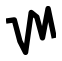

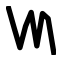

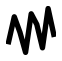

In [5]:
###########################################################
## This cell can be skipped if the dataset is downloaded ##
###########################################################
for i in range(0,len(print_data)): # Create black & white line plots for each sample (row) in the dataset
    
    pddata=print_data.iloc[i,:]
    data = pddata.to_numpy()

    plt.figure(figsize=(1, 1),dpi=64)
    
    plt.plot(indices,data, linewidth=6, color='black')
    plt.axis('off')
    istr = f'{i}'

    plt.savefig('./BWLineData/data'+istr+'.png')

    Image.open('./BWLineData/data'+istr+'.png').convert('L').save('./BWLineData/data'+istr+'.png') # Convert the plot to 1 channel black & white image data
    
    if i > 2 :
        plt.close()

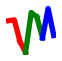

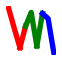

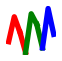

In [6]:
###########################################################
## This cell can be skipped if the dataset is downloaded ##
###########################################################
for i in range(0,len(print_data)): # Create RGB line plots for each sample (row) in the dataset
    
    pddata=print_data.iloc[i,:]
    data = pddata.to_numpy()

    plt.figure(figsize=(1, 1),dpi=64)
    
    plt.plot(indices[0:3],data[0:3], linewidth=6, color='red')
    plt.plot(indices[2:4],data[2:4], linewidth=6, color='red')
    plt.plot(indices[3:6],data[3:6], linewidth=6, color='green')
    plt.plot(indices[5:7],data[5:7], linewidth=6, color='green')
    plt.plot(indices[6:9],data[6:9], linewidth=6, color='blue')
    plt.axis('off')
    istr = f'{i}'

    plt.savefig('./RGBLineData/data'+istr+'.png')

    Image.open('./RGBLineData/data'+istr+'.png').convert('RGB').save('./RGBLineData/data'+istr+'.png') # Convert the plot to 3 channel RGB image data

    if i > 2 :
        plt.close()

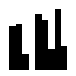

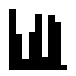

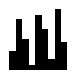

In [7]:
###########################################################
## This cell can be skipped if the dataset is downloaded ##
###########################################################
for i in range(0,len(print_data)): # Create black & white bar plots for each sample (row) in the dataset
    
    pddata=print_data.iloc[i,:]
    data = pddata.to_numpy()

    fig = plt.figure(figsize=(1, 1),dpi=64)
    ax = fig.add_axes([0,0,1,1])
    ax.bar(indices,data,color = 'black', width=1)
    
    plt.axis('off')
    istr = f'{i}'

    plt.savefig('./BWBarData/data'+istr+'.png')

    Image.open('./BWBarData/data'+istr+'.png').convert('L').save('./BWBarData/data'+istr+'.png') # Convert the plot to 1 channel black & white image data
    
    if i > 2 :
        plt.close(fig)

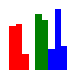

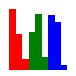

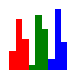

In [8]:
###########################################################
## This cell can be skipped if the dataset is downloaded ##
###########################################################
for i in range(0,len(print_data)): # Create RGB bar plots for each sample (row) in the dataset
    
    pddata=print_data.iloc[i,:]
    data = pddata.to_numpy()

    fig = plt.figure(figsize=(1, 1),dpi=64)
    ax = fig.add_axes([0,0,1,1])
    ax.bar(indices[0:3],data[0:3], width=1, color='red')
    ax.bar(indices[2:4],data[2:4], width=1, color='red')
    ax.bar(indices[3:6],data[3:6], width=1, color='green')
    ax.bar(indices[5:7],data[5:7], width=1, color='green')
    ax.bar(indices[6:9],data[6:9], width=1, color='blue')
    
    plt.axis('off')
    istr = f'{i}'

    plt.savefig('./RGBBarData/data'+istr+'.png')

    Image.open('./RGBBarData/data'+istr+'.png').convert('RGB').save('./RGBBarData/data'+istr+'.png') # Convert the plot to 3 channel RGB image data
    
    if i > 2 :
        plt.close(fig)

<a id='sectiona'></a>
## 2. Model Building and Training

In this section, mainly the dataloaders, models, and the loss function are defined. After defining all the needed classes, the models are trained. 

The proposed Loss function is calculated as:
 
\begin{equation*}
\min_{\theta}{\Bigl(\sum_{i=1}^N \Bigl(\frac{(x_i-\hat{x}_i)^2}{N}\Bigr)+\lambda \sum_{i=1}^N \Bigl(\frac{(\hat{x}_i-m_i)^2}{N}\Bigr)\Bigr)}
\end{equation*}

In [5]:
# Import needed packages for the model building stage
import numpy as np
import pandas as pd
import os
from skimage import io, transform
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
from sklearn_extra.cluster import KMedoids

In [6]:
class PriceDataset(Dataset): #Create a dataset class for image datasets
    """Price dataset."""

    def __init__(self, csv_file, root_dir, transform=None):

        self.image_inf = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.transform = transform

    def __len__(self):
        return len(self.image_inf)

    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()

        img_name = os.path.join(self.root_dir,
                                self.image_inf.iloc[idx, 0]) # Read the ID's of images. 
        image = io.imread(img_name) # Read the image with the current ID.

        sample = image

        if self.transform:
            sample = self.transform(sample) # Transform the image to tensor  

        return sample

In [7]:
transform = transforms.ToTensor() # Image to tensor transformation
price_dataset_BWLine = PriceDataset(csv_file='./BWLineData/ID.csv', 
                                    root_dir='./BWLineData/',transform=transform) # Data set for Black&White Line Images
price_dataset_RGBLine = PriceDataset(csv_file='./RGBLineData/ID.csv',
                                    root_dir='./RGBLineData/',transform=transform) # Data set for RGB Line Images
price_dataset_BWBar = PriceDataset(csv_file='./BWBarData/ID.csv',
                                    root_dir='./BWBarData/',transform=transform) # Data set for Black&White Bar Images
price_dataset_RGBBar = PriceDataset(csv_file='./RGBBarData/ID.csv',
                                    root_dir='./RGBBarData/',transform=transform) # Data set for RGB Bar Images                                                                                                           

dataloader_BWLine = DataLoader(price_dataset_BWLine, batch_size=128, 
                        shuffle=True, num_workers=0) # Dataloader for Black&White Line Images
dataloader_RGBLine = DataLoader(price_dataset_RGBLine, batch_size=128, 
                        shuffle=True, num_workers=0) # Dataloader for RGB Line Images
dataloader_BWBar = DataLoader(price_dataset_BWBar, batch_size=128, 
                        shuffle=True, num_workers=0) # Dataloader for Black&White Bar Images
dataloader_RGBBar = DataLoader(price_dataset_RGBBar, batch_size=128, 
                        shuffle=True, num_workers=0) # Dataloader for RGB Bar Images                                                                     

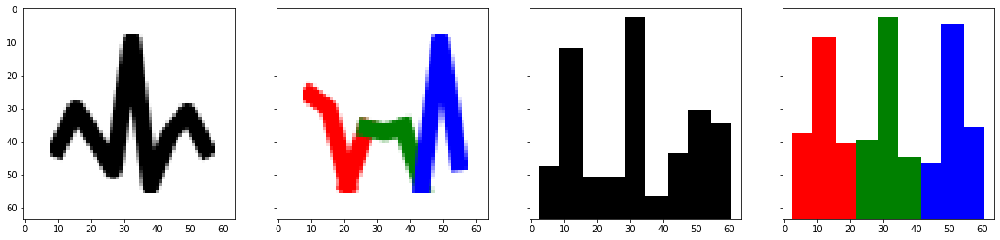

In [8]:
##################################################
### Visualize one sample from each of datasets ###
##################################################
fig, axes = plt.subplots(nrows=1, ncols=4, sharex=True, sharey=True, figsize=(20,5))
#BWLine data
dataiter = iter(dataloader_BWLine) 

images = dataiter.next() 
images = images.permute(0, 2, 3, 1) 
images = images.numpy() 
img = np.squeeze(images[0])

axes[0].imshow(img, cmap='gray')
#RGBLine data
dataiter = iter(dataloader_RGBLine)

images = dataiter.next()
images = images.permute(0, 2, 3, 1)
images = images.numpy()
img = np.squeeze(images[0])

axes[1].imshow(img)
#BWBar data
dataiter = iter(dataloader_BWBar)

images = dataiter.next()
images = images.permute(0, 2, 3, 1)
images = images.numpy()
img = np.squeeze(images[0])

axes[2].imshow(img, cmap='gray')
#RGBBar data
dataiter = iter(dataloader_RGBBar)

images = dataiter.next()
images = images.permute(0, 2, 3, 1)
images = images.numpy()
img = np.squeeze(images[0])

axes[3].imshow(img)
  

In [10]:
class ConvAutoencoder(nn.Module): #Convolutional Autoencoder with KMedoids Class for Grayscale images
    def __init__(self):
        super(ConvAutoencoder, self).__init__()
        ## encoder part ##
        self.conv1 = nn.Conv2d(1, 16, 3, padding=1) # depth from 1 to 16, 3x3 kernels with 1 padding, size stay same. 
        self.conv2 = nn.Conv2d(16, 4, 3, padding=1) # depth from 16 to 4, 3x3 kernels with 1 padding, size stay same. 
        self.pool = nn.MaxPool2d(2, 2) # pooling layer to reduce sizes by half; kernel and stride of 2
        
        ## decoder part ##
        self.t_conv1 = nn.ConvTranspose2d(4, 16, 2, stride=2) ## a kernel of 2 and a stride of 2 will double sizes
        self.t_conv2 = nn.ConvTranspose2d(16, 1, 2, stride=2) ## a kernel of 2 and a stride of 2 will double sizes

    def forward(self, x):
        ## Encode ##
        x = F.relu(self.conv1(x)) # Layer 1 and ReLU
        x = self.pool(x) # Maxpool
        # add second hidden layer
        x = F.relu(self.conv2(x)) # Layer 2 and ReLU
        latent_representation = self.pool(x) # compressed representation
        x = self.pool(x) # compressed representation
        latent_representation_flat=np.reshape(latent_representation.detach().numpy(), (latent_representation.shape[0], -1))
        ## Cluster ##
        # Apply K-Means algorithm to find batch-wise clusters
        kmedoids_layer = KMedoids(n_clusters=7).fit(latent_representation_flat) # Create cluster model
        kmeans_clusters = kmedoids_layer.labels_ # Get cluster assignments
        kmeans_centers = kmedoids_layer.cluster_centers_ # Get cluster centers(medoids)
        ## Decode ##
        x = F.relu(self.t_conv1(x))
        x = F.sigmoid(self.t_conv2(x))  # output layer (with sigmoid for scaling from 0 to 1)
                
        return x,kmeans_clusters,kmeans_centers,latent_representation_flat

# initialize the BW models
modelBWline = ConvAutoencoder()
modelBWbar = ConvAutoencoder()
print(modelBWline)

ConvAutoencoder(
  (conv1): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(16, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (t_conv1): ConvTranspose2d(4, 16, kernel_size=(2, 2), stride=(2, 2))
  (t_conv2): ConvTranspose2d(16, 1, kernel_size=(2, 2), stride=(2, 2))
)


In [11]:
class ConvAutoencoderRGB(nn.Module): #Convolutional Autoencoder with KMedoids Class for RGB images
    def __init__(self):
        super(ConvAutoencoderRGB, self).__init__()
        ## encoder part ##
        self.conv1 = nn.Conv2d(3, 16, 3, padding=1) # depth from 1 to 16, 3x3 kernels with 1 padding, size stay same. 
        self.conv2 = nn.Conv2d(16, 4, 3, padding=1) # depth from 16 to 4, 3x3 kernels with 1 padding, size stay same.
        self.pool = nn.MaxPool2d(2, 2) # pooling layer to reduce sizes by half; kernel and stride of 2
        
        ## decoder part ##
        self.t_conv1 = nn.ConvTranspose2d(4, 16, 2, stride=2) ## a kernel of 2 and a stride of 2 will double sizes
        self.t_conv2 = nn.ConvTranspose2d(16, 3, 2, stride=2) ## a kernel of 2 and a stride of 2 will double sizes


    def forward(self, x):
        ## Encode ##
        x = F.relu(self.conv1(x)) # Layer 1 and ReLU
        x = self.pool(x) # Maxpool
        # add second hidden layer
        x = F.relu(self.conv2(x)) # Layer 2 and ReLU
        latent_representation = self.pool(x) # compressed representation
        x = self.pool(x) # compressed representation
        latent_representation_flat=np.reshape(latent_representation.detach().numpy(), (latent_representation.shape[0], -1))
        ## Cluster ##
        # Apply K-Means algorithm to find batch-wise clusters
        kmedoids_layer = KMedoids(n_clusters=7).fit(latent_representation_flat) # Create cluster model
        kmeans_clusters = kmedoids_layer.labels_ # Get cluster assignments
        kmeans_centers = kmedoids_layer.cluster_centers_ # Get cluster centers(medoids)
        ## Decode ##
        x = F.relu(self.t_conv1(x))
        x = F.sigmoid(self.t_conv2(x)) # output layer (with sigmoid for scaling from 0 to 1)
                
        return x,kmeans_clusters,kmeans_centers,latent_representation_flat

# initialize the RGB models
modelRGBline = ConvAutoencoderRGB()
modelRGBbar = ConvAutoencoderRGB()
print(modelRGBline)

ConvAutoencoderRGB(
  (conv1): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2): Conv2d(16, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (t_conv1): ConvTranspose2d(4, 16, kernel_size=(2, 2), stride=(2, 2))
  (t_conv2): ConvTranspose2d(16, 3, kernel_size=(2, 2), stride=(2, 2))
)


In [12]:
class KMedoidsCustomLoss(torch.nn.Module): # Clustering Loss for training
    def __init__(self):
        super(KMedoidsCustomLoss,self).__init__()
        self.criterion_clust = nn.MSELoss()

    def forward(self, images, latent_flat, centers,assignments):
        index=np.where((latent_flat==centers[:,None]).all(-1))[1] #Found which rows of latent variables are the mediods

        medoids=images[index] # Found the tensor of medoids from 0 to K-1

        medoids_extend=medoids[assignments] # Extend the medoid tensor to match with each observation 

        loss=self.criterion_clust(medoids_extend,images) # Calculate MSE loss

        return loss
      
KMloss = KMedoidsCustomLoss()
# specify loss function
criterion = nn.MSELoss()

# specify optimizer
optimizerBWline = torch.optim.Adam(modelBWline.parameters(), lr=0.001)
optimizerBWbar = torch.optim.Adam(modelBWbar.parameters(), lr=0.001)
optimizerRGBline = torch.optim.Adam(modelRGBline.parameters(), lr=0.001)
optimizerRGBbar = torch.optim.Adam(modelRGBbar.parameters(), lr=0.001)

In [13]:
class KMedoidsCustomLossTest(torch.nn.Module): # Clustering Loss for test
    def __init__(self):
        super(KMedoidsCustomLossTest,self).__init__()
        self.criterion_clust = nn.MSELoss()

    def forward(self, images, index ,assignments):

        medoids=images[index] # Found the tensor of medoids from 0 to K-1(check???)

        medoids_extend=medoids[assignments] # Extend the medoid tensor to match with each observation (check???)

        loss=self.criterion_clust(medoids_extend,images) # Calculate MSE loss

        return loss
KMlosstest = KMedoidsCustomLossTest()       

In [14]:
################################################
## Train the model with Grayscale Line images ##
################################################
n_epochs = 50 

for epoch in range(1, n_epochs+1):

    train_loss = 0.0
    reconstruction_loss = 0.0
    cluster_loss = 0.0
    
    for data in dataloader_BWLine:
        
        images = data
        # clear the gradients of all optimized variables
        optimizerBWline.zero_grad()
        # forward pass
        outputs, assignments, centers, latent_flat = modelBWline(images)

        # calculate the loss
        loss_reconstruction = criterion(outputs, images)#RCons loss
        loss_cluster = KMloss(outputs,latent_flat,centers,assignments)  #output veya image konulabilir
        loss = loss_reconstruction + 0.5*loss_cluster

        # backward pass
        loss.backward()
        
        # perform a single optimization step (parameter update)
        optimizerBWline.step()
        # update losses
        train_loss += loss.item()*images.size(0)
        reconstruction_loss += loss_reconstruction.item()*images.size(0)
        cluster_loss += loss_cluster.item()*images.size(0)
            
    # print avg training statistics 
    train_loss = train_loss/len(dataloader_BWLine)
    reconstruction_loss = reconstruction_loss/len(dataloader_BWLine)
    cluster_loss = cluster_loss/len(dataloader_BWLine)
    print('Epoch: {} \tTraining Loss: {:.6f} \tReconstruction Loss: {:.6f} \tCluster Loss: {:.6f}'.format(
        epoch, 
        train_loss,
        reconstruction_loss,
        cluster_loss
        ))
torch.save(modelBWline.state_dict(),'./modelBWLine.pth')

Epoch: 1 	Training Loss: 23.948414 	Reconstruction Loss: 23.701616 	Cluster Loss: 0.493597
Epoch: 2 	Training Loss: 8.005496 	Reconstruction Loss: 5.893607 	Cluster Loss: 4.223779
Epoch: 3 	Training Loss: 6.911290 	Reconstruction Loss: 4.506468 	Cluster Loss: 4.809644
Epoch: 4 	Training Loss: 5.591843 	Reconstruction Loss: 2.680855 	Cluster Loss: 5.821977
Epoch: 5 	Training Loss: 5.380173 	Reconstruction Loss: 2.405794 	Cluster Loss: 5.948756
Epoch: 6 	Training Loss: 5.258248 	Reconstruction Loss: 2.235171 	Cluster Loss: 6.046153
Epoch: 7 	Training Loss: 5.097342 	Reconstruction Loss: 2.015962 	Cluster Loss: 6.162760
Epoch: 8 	Training Loss: 5.013276 	Reconstruction Loss: 1.862200 	Cluster Loss: 6.302153
Epoch: 9 	Training Loss: 4.957123 	Reconstruction Loss: 1.785874 	Cluster Loss: 6.342498
Epoch: 10 	Training Loss: 4.914617 	Reconstruction Loss: 1.739224 	Cluster Loss: 6.350785
Epoch: 11 	Training Loss: 4.873949 	Reconstruction Loss: 1.702682 	Cluster Loss: 6.342534
Epoch: 12 	Traini

In [16]:
################################################
## Train the model with RGB Line images ##
################################################
n_epochs = 50 

for epoch in range(1, n_epochs+1):
    # monitor training loss
    train_loss = 0.0
    reconstruction_loss = 0.0
    cluster_loss = 0.0
    
    for data in dataloader_RGBLine:

        images = data

        # clear the gradients of all optimized variables
        optimizerRGBline.zero_grad()
        
        # forward pass
        outputs, assignments, centers, latent_flat = modelRGBline(images)

        # calculate the loss
        loss_reconstruction = criterion(outputs, images)#RCons loss
        loss_cluster = KMloss(outputs,latent_flat,centers,assignments)  #output veya image konulabilir
        loss = loss_reconstruction + 0.5*loss_cluster

        # backward pass
        loss.backward()
        
        # perform a single optimization step (parameter update)
        optimizerRGBline.step()
        # update losses
        train_loss += loss.item()*images.size(0)
        reconstruction_loss += loss_reconstruction.item()*images.size(0)
        cluster_loss += loss_cluster.item()*images.size(0)
            
    # print avg training statistics 
    train_loss = train_loss/len(dataloader_RGBLine)
    reconstruction_loss = reconstruction_loss/len(dataloader_RGBLine)
    cluster_loss = cluster_loss/len(dataloader_RGBLine)
    print('Epoch: {} \tTraining Loss: {:.6f} \tReconstruction Loss: {:.6f} \tCluster Loss: {:.6f}'.format(
        epoch, 
        train_loss,
        reconstruction_loss,
        cluster_loss
        ))
torch.save(modelRGBline.state_dict(),'./modelRGBline.pth')

Epoch: 1 	Training Loss: 21.569944 	Reconstruction Loss: 21.535251 	Cluster Loss: 0.069386
Epoch: 2 	Training Loss: 10.921268 	Reconstruction Loss: 10.586371 	Cluster Loss: 0.669793
Epoch: 3 	Training Loss: 8.792063 	Reconstruction Loss: 7.880036 	Cluster Loss: 1.824054
Epoch: 4 	Training Loss: 7.840680 	Reconstruction Loss: 6.687531 	Cluster Loss: 2.306298
Epoch: 5 	Training Loss: 6.728404 	Reconstruction Loss: 5.359064 	Cluster Loss: 2.738680
Epoch: 6 	Training Loss: 6.091823 	Reconstruction Loss: 4.540426 	Cluster Loss: 3.102795
Epoch: 7 	Training Loss: 5.717036 	Reconstruction Loss: 4.031087 	Cluster Loss: 3.371898
Epoch: 8 	Training Loss: 5.421249 	Reconstruction Loss: 3.618325 	Cluster Loss: 3.605847
Epoch: 9 	Training Loss: 5.116690 	Reconstruction Loss: 3.202284 	Cluster Loss: 3.828813
Epoch: 10 	Training Loss: 4.766025 	Reconstruction Loss: 2.745653 	Cluster Loss: 4.040745
Epoch: 11 	Training Loss: 4.495357 	Reconstruction Loss: 2.383045 	Cluster Loss: 4.224623
Epoch: 12 	Trai

In [17]:
################################################
## Train the model with Grayscale Bar images ##
################################################
n_epochs = 50 

for epoch in range(1, n_epochs+1):
    # monitor training loss
    train_loss = 0.0
    reconstruction_loss = 0.0
    cluster_loss = 0.0
    
    for data in dataloader_BWBar:

        images = data
        
        # clear the gradients of all optimized variables
        optimizerBWbar.zero_grad()
        
        # forward pass
        outputs, assignments, centers, latent_flat = modelBWbar(images)

        # calculate the loss
        loss_reconstruction = criterion(outputs, images)#RCons loss
        loss_cluster = KMloss(outputs,latent_flat,centers,assignments)  #output veya image konulabilir
        loss = loss_reconstruction + 0.5*loss_cluster

        # backward pass
        loss.backward()
        
        # perform a single optimization step (parameter update)
        optimizerBWbar.step()
        # update losses
        train_loss += loss.item()*images.size(0)
        reconstruction_loss += loss_reconstruction.item()*images.size(0)
        cluster_loss += loss_cluster.item()*images.size(0)
            
    # print avg training statistics 
    train_loss = train_loss/len(dataloader_BWBar)
    reconstruction_loss = reconstruction_loss/len(dataloader_BWBar)
    cluster_loss = cluster_loss/len(dataloader_BWBar)
    print('Epoch: {} \tTraining Loss: {:.6f} \tReconstruction Loss: {:.6f} \tCluster Loss: {:.6f}'.format(
        epoch, 
        train_loss,
        reconstruction_loss,
        cluster_loss
        ))
torch.save(modelBWbar.state_dict(),'./modelBWbar.pth')

Epoch: 1 	Training Loss: 24.092617 	Reconstruction Loss: 23.651742 	Cluster Loss: 0.881750
Epoch: 2 	Training Loss: 11.847079 	Reconstruction Loss: 9.083053 	Cluster Loss: 5.528052
Epoch: 3 	Training Loss: 8.093737 	Reconstruction Loss: 4.230323 	Cluster Loss: 7.726827
Epoch: 4 	Training Loss: 7.156251 	Reconstruction Loss: 2.852827 	Cluster Loss: 8.606848
Epoch: 5 	Training Loss: 6.687953 	Reconstruction Loss: 2.290916 	Cluster Loss: 8.794074
Epoch: 6 	Training Loss: 6.445774 	Reconstruction Loss: 1.994308 	Cluster Loss: 8.902932
Epoch: 7 	Training Loss: 6.312836 	Reconstruction Loss: 1.917557 	Cluster Loss: 8.790559
Epoch: 8 	Training Loss: 6.224315 	Reconstruction Loss: 1.890483 	Cluster Loss: 8.667664
Epoch: 9 	Training Loss: 6.131175 	Reconstruction Loss: 1.846907 	Cluster Loss: 8.568536
Epoch: 10 	Training Loss: 6.047745 	Reconstruction Loss: 1.822801 	Cluster Loss: 8.449886
Epoch: 11 	Training Loss: 6.017731 	Reconstruction Loss: 1.792600 	Cluster Loss: 8.450262
Epoch: 12 	Train

In [18]:
################################################
## Train the model with RGB Bar images ##
################################################
n_epochs = 50 

for epoch in range(1, n_epochs+1):
    # monitor training loss
    train_loss = 0.0
    reconstruction_loss = 0.0
    cluster_loss = 0.0
    
    for data in dataloader_RGBBar:

        images = data
        
        # clear the gradients of all optimized variables
        optimizerRGBbar.zero_grad()
        
        # forward pass
        outputs, assignments, centers, latent_flat = modelRGBbar(images)

        # calculate the loss
        loss_reconstruction = criterion(outputs, images)#RCons loss
        loss_cluster = KMloss(outputs,latent_flat,centers,assignments)  #output veya image konulabilir
        loss = loss_reconstruction + 0.5*loss_cluster
        
        # backward pass
        loss.backward()
        
        # perform a single optimization step (parameter update)
        optimizerRGBbar.step()
        # update losses
        train_loss += loss.item()*images.size(0)
        reconstruction_loss += loss_reconstruction.item()*images.size(0)
        cluster_loss += loss_cluster.item()*images.size(0)
            
    # print avg training statistics 
    train_loss = train_loss/len(dataloader_RGBBar)
    reconstruction_loss = reconstruction_loss/len(dataloader_RGBBar)
    cluster_loss = cluster_loss/len(dataloader_RGBBar)
    print('Epoch: {} \tTraining Loss: {:.6f} \tReconstruction Loss: {:.6f} \tCluster Loss: {:.6f}'.format(
        epoch, 
        train_loss,
        reconstruction_loss,
        cluster_loss
        ))
torch.save(modelRGBbar.state_dict(),'./modelRGBbar.pth')

Epoch: 1 	Training Loss: 24.570808 	Reconstruction Loss: 24.451974 	Cluster Loss: 0.237670
Epoch: 2 	Training Loss: 16.852147 	Reconstruction Loss: 16.013502 	Cluster Loss: 1.677289
Epoch: 3 	Training Loss: 13.133386 	Reconstruction Loss: 11.430078 	Cluster Loss: 3.406617
Epoch: 4 	Training Loss: 9.509935 	Reconstruction Loss: 7.325398 	Cluster Loss: 4.369074
Epoch: 5 	Training Loss: 7.770040 	Reconstruction Loss: 5.111304 	Cluster Loss: 5.317472
Epoch: 6 	Training Loss: 7.117574 	Reconstruction Loss: 4.222420 	Cluster Loss: 5.790308
Epoch: 7 	Training Loss: 6.545083 	Reconstruction Loss: 3.505895 	Cluster Loss: 6.078377
Epoch: 8 	Training Loss: 6.147312 	Reconstruction Loss: 3.019304 	Cluster Loss: 6.256015
Epoch: 9 	Training Loss: 5.949932 	Reconstruction Loss: 2.790877 	Cluster Loss: 6.318109
Epoch: 10 	Training Loss: 5.840434 	Reconstruction Loss: 2.686450 	Cluster Loss: 6.307968
Epoch: 11 	Training Loss: 5.720529 	Reconstruction Loss: 2.607065 	Cluster Loss: 6.226928
Epoch: 12 	Tr

<a id='sectionc'></a>
## 3. Results

In the results part, we tried to examine the results we obtain from the model both in aspects of image reconstruction performances and clustering performances.

In [41]:
##############################################################
## If you retrained the algorithms this part can be skipped ##
##############################################################
modelRGBline = ConvAutoencoderRGB()
modelRGBbar = ConvAutoencoderRGB()
modelBWline = ConvAutoencoder()
modelBWbar = ConvAutoencoder()
modelRGBline.load_state_dict(torch.load('./modelRGBline.pth'))
modelRGBbar.load_state_dict(torch.load('./modelRGBbar.pth'))
modelBWline.load_state_dict(torch.load('./modelBWLine.pth'))
modelBWbar.load_state_dict(torch.load('./modelBWbar.pth'))

<All keys matched successfully>

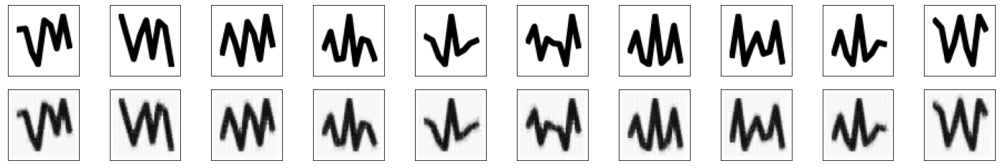

In [42]:
batch_size=20
dataloadertest_BWLine = DataLoader(price_dataset_BWLine, batch_size=20, #torch.utils.data.
                        shuffle=False, num_workers=0)
# obtain one batch of test images
dataiter = iter(dataloadertest_BWLine)
images = dataiter.next()

# get sample outputs
output, assignments, centers, latent_flat = modelBWline(images)
# prep images for display
images = images.numpy()

# output is resized into a batch of iages 
output = output.view(batch_size, 1, 64, 64)
# use detach when it's an output that requires_grad
output = output.detach().numpy()

# plot the first ten input images and then reconstructed images
fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(25,4))

# input images on top row, reconstructions on bottom
for images, row in zip([images, output], axes):
    for img, ax in zip(images, row):
        ax.imshow(np.squeeze(img), cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

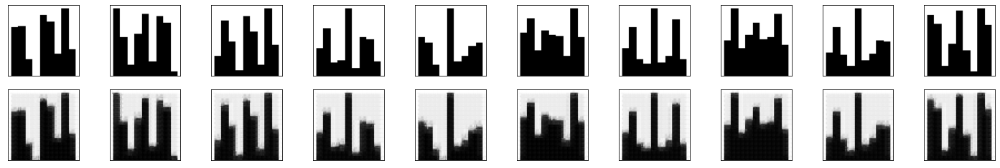

In [20]:
batch_size=20
dataloadertest_BWBar = DataLoader(price_dataset_BWBar, batch_size=20, #torch.utils.data.
                        shuffle=False, num_workers=0)
# obtain one batch of test images
dataiter = iter(dataloadertest_BWBar)
images = dataiter.next()

# get sample outputs
output, assignments, centers, latent_flat = modelBWbar(images)
# prep images for display
images = images.numpy()

# output is resized into a batch of iages 
output = output.view(batch_size, 1, 64, 64)
# use detach when it's an output that requires_grad
output = output.detach().numpy()

# plot the first ten input images and then reconstructed images
fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(25,4))

# input images on top row, reconstructions on bottom
for images, row in zip([images, output], axes):
    for img, ax in zip(images, row):
        ax.imshow(np.squeeze(img), cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

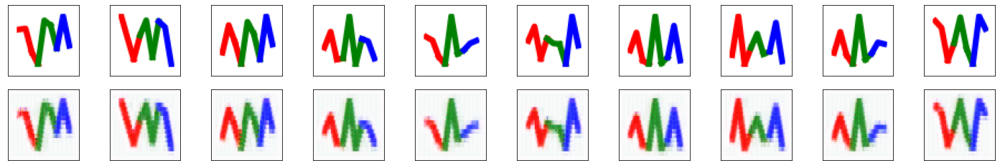

In [21]:
batch_size=20

dataloadertest_RGBLine = DataLoader(price_dataset_RGBLine, batch_size=20, #torch.utils.data.
                        shuffle=False, num_workers=0)
# obtain one batch of test images
dataiter = iter(dataloadertest_RGBLine)
images = dataiter.next()

# get sample outputs
output, assignments, centers, latent_flat = modelRGBline(images)

# prep images for display
images = images.permute(0, 2, 3, 1)
images = images.numpy()

# output is resized into a batch of iages 
output = output.view(batch_size, 3, 64, 64)
# use detach when it's an output that requires_grad
output = output.permute(0, 2, 3, 1)
output = output.detach().numpy()

# plot the first ten input images and then reconstructed images
fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(25,4))

# input images on top row, reconstructions on bottom
for images, row in zip([images, output], axes):
    for img, ax in zip(images, row):
        ax.imshow(np.squeeze(img))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

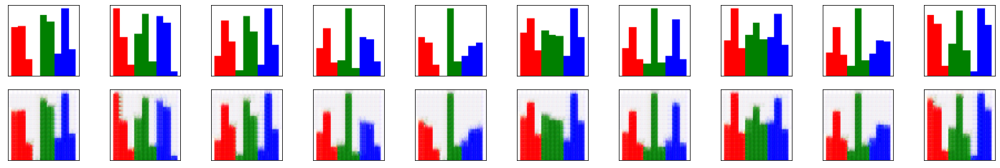

In [22]:
batch_size=20

dataloadertest_RGBBar = DataLoader(price_dataset_RGBBar, batch_size=20, #torch.utils.data.
                        shuffle=False, num_workers=0)
# obtain one batch of test images
dataiter = iter(dataloadertest_RGBBar)
images = dataiter.next()

# get sample outputs
output, assignments, centers, latent_flat = modelRGBbar(images)

# prep images for display
images = images.permute(0, 2, 3, 1)
images = images.numpy()

# output is resized into a batch of iages 
output = output.view(batch_size, 3, 64, 64)
# use detach when it's an output that requires_grad
output = output.permute(0, 2, 3, 1)
output = output.detach().numpy()

# plot the first ten input images and then reconstructed images
fig, axes = plt.subplots(nrows=2, ncols=10, sharex=True, sharey=True, figsize=(25,4))

# input images on top row, reconstructions on bottom
for images, row in zip([images, output], axes):
    for img, ax in zip(images, row):
        ax.imshow(np.squeeze(img))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

In [24]:
latent_dataset_BWLine = [] # Create an empty array for latent representation of BW line images.
for data in dataloadertest_BWLine: # Loop over the dataset through mini-batches.
    images = data # Assing data batches as image.
    output, assignments, centers, latent_flat = modelBWline(images) # Run the model to obtain latent representations of the batch.
    latent_dataset_BWLine.append(latent_flat) # Append all the latent representations.

latent_dataset_RGBLine = [] # Create an empty array for laternt representation of RGB line images.
for data in dataloadertest_RGBLine: # Loop over the dataset through mini-batches.
    images = data # Assing data batches as image.
    output, assignments, centers, latent_flat = modelRGBline(images) # Run the model to obtain latent representations of the batch.
    latent_dataset_RGBLine.append(latent_flat) # Append all the latent representations.

latent_dataset_BWBar = [] # Create an empty array for laternt representation of BW bar images.
for data in dataloadertest_BWBar: # Loop over the dataset through mini-batches.
    images = data # Assing data batches as image.
    output, assignments, centers, latent_flat = modelBWbar(images) # Run the model to obtain latent representations of the batch.
    latent_dataset_BWBar.append(latent_flat) # Append all the latent representations.

latent_dataset_RGBBar = [] # Create an empty array for laternt representation of RGB bar images.
for data in dataloadertest_RGBBar: # Loop over the dataset through mini-batches.
    images = data # Assing data batches as image.
    output, assignments, centers, latent_flat = modelRGBbar(images) # Run the model to obtain latent representations of the batch.
    latent_dataset_RGBBar.append(latent_flat) # Append all the latent representations.            

In [25]:
latent_dataset_BWLine=np.concatenate( latent_dataset_BWLine, axis=0 ) # Concatenate all batches to form one array of data.
latent_dataset_RGBLine=np.concatenate( latent_dataset_RGBLine, axis=0 ) # Concatenate all batches to form one array of data.
latent_dataset_BWBar=np.concatenate( latent_dataset_BWBar, axis=0 ) # Concatenate all batches to form one array of data.
latent_dataset_RGBBar=np.concatenate( latent_dataset_RGBBar, axis=0 ) # Concatenate all batches to form one array of data.
print(latent_dataset_BWLine.shape) # Print the shape to see if there is any dimension mismatch. 
print(latent_dataset_RGBLine.shape) # Print the shape to see if there is any dimension mismatch. 
print(latent_dataset_BWBar.shape) # Print the shape to see if there is any dimension mismatch. 
print(latent_dataset_RGBBar.shape) # Print the shape to see if there is any dimension mismatch. 

(14293, 1024)
(14293, 1024)
(14293, 1024)
(14293, 1024)


In [26]:
latent_dataset_BWLine = pd.DataFrame(latent_dataset_BWLine) # Convert the data array to a data frame. 
latent_dataset_RGBLine = pd.DataFrame(latent_dataset_RGBLine) # Convert the data array to a data frame. 
latent_dataset_BWBar = pd.DataFrame(latent_dataset_BWBar) # Convert the data array to a data frame. 
latent_dataset_RGBBar = pd.DataFrame(latent_dataset_RGBBar) # Convert the data array to a data frame. 
latent_dataset_RGBBar.head() # Check first five rows. 

,0,1,2,3,4,5,6,7,8,9,...,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
0,44.525898,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,...,17.318647,32.859573,5.630526,6.088258,3.438001,14.566734,13.274215,13.274215,13.274215,19.308826
1,43.155434,41.731033,42.530006,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,...,7.769740,5.630526,5.630526,6.088258,3.438001,14.566734,13.274215,11.519107,12.139714,19.439054
2,44.525898,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,...,6.072158,9.141884,5.630526,6.088258,3.438001,14.566734,13.274215,13.274215,13.274215,19.308826
3,44.525898,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,46.685017,41.969814,44.525696,...,7.769740,5.630526,5.630526,6.088258,3.438001,14.566734,13.274215,13.274215,13.274215,19.308826
4,44.525898,44.525696,44.525696,44.525696,44.525696,44.525696,44.525696,46.685017,41.969814,44.525696,...,17.318647,32.859573,5.630526,6.088258,3.438001,14.566734,13.274215,13.274215,13.274215,19.308826


In [28]:
base_clustermodel=KMedoids(n_clusters=7).fit(print_data)
BWLine_clustermodel=KMedoids(n_clusters=7).fit(latent_dataset_BWLine) # Create a cluster model using all the dataset formed by latent representations of B&W line charts.
RGBLine_clustermodel=KMedoids(n_clusters=7).fit(latent_dataset_RGBLine) # Create a cluster model using all the dataset formed by latent representations of B&W line charts.
BWBar_clustermodel=KMedoids(n_clusters=7).fit(latent_dataset_BWBar) # Create a cluster model using all the dataset formed by latent representations of B&W line charts.
RGBBar_clustermodel=KMedoids(n_clusters=7).fit(latent_dataset_RGBBar) # Create a cluster model using all the dataset formed by latent representations of B&W line charts.

In [30]:
###############################################################
## Calculate clustering losses of each model on each dataset ##
###############################################################
dataloaderloss_BWLine = DataLoader(price_dataset_BWLine, batch_size=14293, 
                        shuffle=False, num_workers=0)
dataloaderloss_RGBLine = DataLoader(price_dataset_RGBLine, batch_size=14293, 
                        shuffle=False, num_workers=0)
dataloaderloss_BWBar = DataLoader(price_dataset_BWBar, batch_size=14293, 
                        shuffle=False, num_workers=0)
dataloaderloss_RGBBar = DataLoader(price_dataset_RGBBar, batch_size=14293, 
                        shuffle=False, num_workers=0)

for data in dataloaderloss_BWLine:
    images = data
    BWLine_clustermodel_loss = KMlosstest(images,BWLine_clustermodel.medoid_indices_,BWLine_clustermodel.labels_)
    RGBLine_clustermodel_loss = KMlosstest(images,RGBLine_clustermodel.medoid_indices_,RGBLine_clustermodel.labels_)
    BWBar_clustermodel_loss = KMlosstest(images,BWBar_clustermodel.medoid_indices_,BWBar_clustermodel.labels_)
    RGBBar_clustermodel_loss = KMlosstest(images,RGBBar_clustermodel.medoid_indices_,RGBBar_clustermodel.labels_)
    base_clustermodel_loss = KMlosstest(images,base_clustermodel.medoid_indices_,base_clustermodel.labels_)

print('BWline Data:')
print('BWLine_loss: {:.6f} \tRGBLine_loss: {:.6f} \tBWBar_loss: {:.6f} \tRGBBar_loss: {:.6f} \tBase_loss: {:.6f}'.format(
        BWLine_clustermodel_loss, 
        RGBLine_clustermodel_loss,
        BWBar_clustermodel_loss,
        RGBBar_clustermodel_loss,
        base_clustermodel_loss
        ))

for data in dataloaderloss_RGBLine:
    images = data
    BWLine_clustermodel_loss = KMlosstest(images,BWLine_clustermodel.medoid_indices_,BWLine_clustermodel.labels_)
    RGBLine_clustermodel_loss = KMlosstest(images,RGBLine_clustermodel.medoid_indices_,RGBLine_clustermodel.labels_)
    BWBar_clustermodel_loss = KMlosstest(images,BWBar_clustermodel.medoid_indices_,BWBar_clustermodel.labels_)
    RGBBar_clustermodel_loss = KMlosstest(images,RGBBar_clustermodel.medoid_indices_,RGBBar_clustermodel.labels_)
    base_clustermodel_loss = KMlosstest(images,base_clustermodel.medoid_indices_,base_clustermodel.labels_)

print('RGBLine Data:')
print('BWLine_loss: {:.6f} \tRGBLine_loss: {:.6f} \tBWBar_loss: {:.6f} \tRGBBar_loss: {:.6f} \tBase_loss: {:.6f}'.format(
        BWLine_clustermodel_loss, 
        RGBLine_clustermodel_loss,
        BWBar_clustermodel_loss,
        RGBBar_clustermodel_loss,
        base_clustermodel_loss
        ))

for data in dataloaderloss_BWBar:
    images = data
    BWLine_clustermodel_loss = KMlosstest(images,BWLine_clustermodel.medoid_indices_,BWLine_clustermodel.labels_)
    RGBLine_clustermodel_loss = KMlosstest(images,RGBLine_clustermodel.medoid_indices_,RGBLine_clustermodel.labels_)
    BWBar_clustermodel_loss = KMlosstest(images,BWBar_clustermodel.medoid_indices_,BWBar_clustermodel.labels_)
    RGBBar_clustermodel_loss = KMlosstest(images,RGBBar_clustermodel.medoid_indices_,RGBBar_clustermodel.labels_)
    base_clustermodel_loss = KMlosstest(images,base_clustermodel.medoid_indices_,base_clustermodel.labels_)

print('BWBar Data:')
print('BWLine_loss: {:.6f} \tRGBLine_loss: {:.6f} \tBWBar_loss: {:.6f} \tRGBBar_loss: {:.6f} \tBase_loss: {:.6f}'.format(
        BWLine_clustermodel_loss, 
        RGBLine_clustermodel_loss,
        BWBar_clustermodel_loss,
        RGBBar_clustermodel_loss,
        base_clustermodel_loss
        ))

for data in dataloaderloss_RGBBar:
    images = data
    BWLine_clustermodel_loss = KMlosstest(images,BWLine_clustermodel.medoid_indices_,BWLine_clustermodel.labels_)
    RGBLine_clustermodel_loss = KMlosstest(images,RGBLine_clustermodel.medoid_indices_,RGBLine_clustermodel.labels_)
    BWBar_clustermodel_loss = KMlosstest(images,BWBar_clustermodel.medoid_indices_,BWBar_clustermodel.labels_)
    RGBBar_clustermodel_loss = KMlosstest(images,RGBBar_clustermodel.medoid_indices_,RGBBar_clustermodel.labels_)
    base_clustermodel_loss = KMlosstest(images,base_clustermodel.medoid_indices_,base_clustermodel.labels_)

print('RGBBar Data:')
print('BWLine_loss: {:.6f} \tRGBLine_loss: {:.6f} \tBWBar_loss: {:.6f} \tRGBBar_loss: {:.6f} \tBase_loss: {:.6f}'.format(
        BWLine_clustermodel_loss, 
        RGBLine_clustermodel_loss,
        BWBar_clustermodel_loss,
        RGBBar_clustermodel_loss,
        base_clustermodel_loss
        ))

BWline Data:
BWLine_loss: 0.093573 	RGBLine_loss: 0.103089 	BWBar_loss: 0.100216 	RGBBar_loss: 0.100416 	Base_loss: 0.101081
RGBLine Data:
BWLine_loss: 0.067325 	RGBLine_loss: 0.074286 	BWBar_loss: 0.071583 	RGBBar_loss: 0.071873 	Base_loss: 0.072284
BWBar Data:
BWLine_loss: 0.123270 	RGBLine_loss: 0.138664 	BWBar_loss: 0.116710 	RGBBar_loss: 0.120063 	Base_loss: 0.118965
RGBBar Data:
BWLine_loss: 0.085944 	RGBLine_loss: 0.097214 	BWBar_loss: 0.081274 	RGBBar_loss: 0.083486 	Base_loss: 0.083079


In [34]:
##############################################################
## Save cluster medoids for further analysis and comparison ##
##############################################################
base_medois_insp = print_data.iloc[base_clustermodel.medoid_indices_,:]
BWLine_medois_insp = print_data.iloc[BWLine_clustermodel.medoid_indices_,:]
RGBLine_medois_insp = print_data.iloc[RGBLine_clustermodel.medoid_indices_,:]
BWBar_medois_insp = print_data.iloc[BWBar_clustermodel.medoid_indices_,:]
RGBBar_medois_insp = print_data.iloc[RGBBar_clustermodel.medoid_indices_,:]

base_medois_insp.to_csv('base_medois_insp.csv')
BWLine_medois_insp.to_csv('BWLine_medois_insp.csv')
RGBLine_medois_insp.to_csv('RGBLine_medois_insp.csv')
BWBar_medois_insp.to_csv('BWBar_medois_insp.csv')
RGBBar_medois_insp.to_csv('RGBBar_medois_insp.csv')

In [40]:
#########################################################
## Find the number of samples assigned to each cluster ##
#########################################################
import collections
elements_count = collections.Counter(BWLine_clustermodel.labels_)
elements_count_sort = sorted(elements_count.items(), key=lambda pair: pair[0], reverse=False)
# printing the element and the frequency
total = 0
for key, value in elements_count_sort:
   print(f"{key}: {value}")
   total += value
print (f"Total: {total}") 

0: 1372
1: 2087
2: 2358
3: 2029
4: 2567
5: 2005
6: 1875
Total: 14293


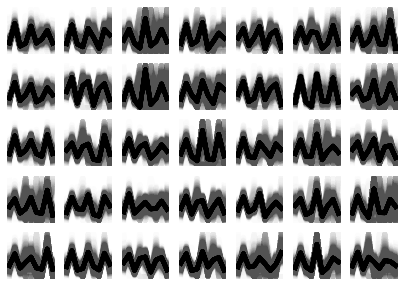

In [39]:
############################################################
## Plot all clusters to see if they are visually matching ##
############################################################
fig, axes = plt.subplots(nrows=5, ncols=7, sharex=False, sharey=False, figsize=(len(BWLine_clustermodel.medoid_indices_),5))

for j in range(0,len(BWLine_clustermodel.medoid_indices_)):

    index_BWLine=np.where(BWLine_clustermodel.labels_==j)[0]
    print_data_ae=print_data.iloc[index_BWLine,:]

    pddata=print_data.iloc[BWLine_clustermodel.medoid_indices_[j],:]
    data = pddata.to_numpy()

    axes[0,j].axis('off')
    axes[0,j].plot(indices,data, linewidth=6, color='black', alpha =1)

    for i in range(0,len(index_BWLine)): # Create plots for each sample (row) in the dataset
        
        pddata=print_data_ae.iloc[i,:]
        data = pddata.to_numpy()

        axes[0,j].axis('off')
        axes[0,j].plot(indices,data, linewidth=6, color='black', alpha =0.01)

for j in range(0,len(RGBLine_clustermodel.medoid_indices_)):

    index_BWLine=np.where(RGBLine_clustermodel.labels_==j)[0]
    print_data_ae=print_data.iloc[index_BWLine,:]

    pddata=print_data.iloc[RGBLine_clustermodel.medoid_indices_[j],:]
    data = pddata.to_numpy()

    axes[1,j].axis('off')
    axes[1,j].plot(indices,data, linewidth=6, color='black', alpha =1)

    for i in range(0,len(index_BWLine)): # Create plots for each sample (row) in the dataset
        
        pddata=print_data_ae.iloc[i,:]
        data = pddata.to_numpy()

        axes[1,j].axis('off')
        axes[1,j].plot(indices,data, linewidth=6, color='black', alpha =0.01)        

for j in range(0,len(BWBar_clustermodel.medoid_indices_)):

    index_BWLine=np.where(BWBar_clustermodel.labels_==j)[0]
    print_data_ae=print_data.iloc[index_BWLine,:]

    pddata=print_data.iloc[BWBar_clustermodel.medoid_indices_[j],:]
    data = pddata.to_numpy()

    axes[2,j].axis('off')
    axes[2,j].plot(indices,data, linewidth=6, color='black', alpha =1)

    for i in range(0,len(index_BWLine)): # Create plots for each sample (row) in the dataset
        
        pddata=print_data_ae.iloc[i,:]
        data = pddata.to_numpy()

        axes[2,j].axis('off')
        axes[2,j].plot(indices,data, linewidth=6, color='black', alpha =0.01)

for j in range(0,len(RGBBar_clustermodel.medoid_indices_)):

    index_BWLine=np.where(RGBBar_clustermodel.labels_==j)[0]
    print_data_ae=print_data.iloc[index_BWLine,:]

    pddata=print_data.iloc[RGBBar_clustermodel.medoid_indices_[j],:]
    data = pddata.to_numpy()

    axes[3,j].axis('off')
    axes[3,j].plot(indices,data, linewidth=6, color='black', alpha =1)

    for i in range(0,len(index_BWLine)): # Create plots for each sample (row) in the dataset
        
        pddata=print_data_ae.iloc[i,:]
        data = pddata.to_numpy()

        axes[3,j].axis('off')
        axes[3,j].plot(indices,data, linewidth=6, color='black', alpha =0.01)

for j in range(0,len(base_clustermodel.medoid_indices_)):

    index_BWLine=np.where(base_clustermodel.labels_==j)[0]
    print_data_ae=print_data.iloc[index_BWLine,:]

    pddata=print_data.iloc[base_clustermodel.medoid_indices_[j],:]
    data = pddata.to_numpy()

    axes[4,j].axis('off')
    axes[4,j].plot(indices,data, linewidth=6, color='black', alpha =1)

    for i in range(0,len(index_BWLine)): # Create plots for each sample (row) in the dataset
        
        pddata=print_data_ae.iloc[i,:]
        data = pddata.to_numpy()

        axes[4,j].axis('off')
        axes[4,j].plot(indices,data, linewidth=6, color='black', alpha =0.01)